In [1]:
import pandas as pd
from moexalgo import Ticker

)
tickers = [
    'AFLT', 'ALRS', 'CHMF', 'GAZP', 'GMKN',
    'LKOH', 'MGNT', 'MOEX', 'MTSS', 'NVTK',
    'ROSN', 'SBER', 'TATN', 'VTBR'
]


start_date = "2015-01-05"
end_date   = "2024-12-30"

for ticker in tickers:
    print(f"Обрабатываем {ticker}...")
    try:

        ticker_obj = Ticker(ticker)

        df_hourly = ticker_obj.candles(start=start_date, end=end_date, period='1h')
        if "begin" in df_hourly.columns:
            df_hourly["begin"] = pd.to_datetime(df_hourly["begin"])
            df_hourly = df_hourly.rename(columns={"begin": "date"})
        globals()[f"df_{ticker}_hourly"] = df_hourly
        print(f"  Почасовые данные для {ticker} сохранены в переменную df_{ticker}_hourly")
    except Exception as e:
        print(f"  Ошибка при получении почасовых данных для {ticker}: {e}")


Обрабатываем AFLT...
  Почасовые данные для AFLT сохранены в переменную df_AFLT_hourly
Обрабатываем ALRS...
  Почасовые данные для ALRS сохранены в переменную df_ALRS_hourly
Обрабатываем CHMF...
  Почасовые данные для CHMF сохранены в переменную df_CHMF_hourly
Обрабатываем GAZP...
  Почасовые данные для GAZP сохранены в переменную df_GAZP_hourly
Обрабатываем GMKN...
  Почасовые данные для GMKN сохранены в переменную df_GMKN_hourly
Обрабатываем LKOH...
  Почасовые данные для LKOH сохранены в переменную df_LKOH_hourly
Обрабатываем MGNT...
  Почасовые данные для MGNT сохранены в переменную df_MGNT_hourly
Обрабатываем MOEX...
  Почасовые данные для MOEX сохранены в переменную df_MOEX_hourly
Обрабатываем MTSS...
  Почасовые данные для MTSS сохранены в переменную df_MTSS_hourly
Обрабатываем NVTK...
  Почасовые данные для NVTK сохранены в переменную df_NVTK_hourly
Обрабатываем ROSN...
  Почасовые данные для ROSN сохранены в переменную df_ROSN_hourly
Обрабатываем SBER...
  Почасовые данные для

In [2]:
df_VTBR_hourly.tail(1)

,open,close,high,low,value,volume,date,end
9999,173.475,173.275,173.5,173.2,19310483.4,556780000.0,2019-01-08 14:00:00,2019-01-08 14:59:59


In [3]:
import pandas as pd
from moexalgo import Ticker
import time  

target_date = pd.to_datetime("2024-12-30")

for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
        df = globals()[var_name]
        df['date'] = pd.to_datetime(df['date'])
        last_date = df['date'].max()
        print(f"\n{ticker}: начальная последняя дата = {last_date.strftime('%Y-%m-%d')}")
        
        while last_date < target_date:
            new_start = (last_date + pd.Timedelta(hours=1)).strftime("%Y-%m-%d")
            try:
                additional_data = Ticker(ticker).candles(start=new_start, end=target_date.strftime("%Y-%m-%d"), period='1h')
            except Exception as e:
                print(f"  Ошибка при догрузке данных для {ticker} с {new_start} до {target_date.strftime('%Y-%m-%d')}: {e}")
                break
            if additional_data.empty:
                print(f"  Для {ticker} нет дополнительных данных с {new_start} до {target_date.strftime('%Y-%m-%d')}.")
                break
            
            if "begin" in additional_data.columns:
                additional_data["begin"] = pd.to_datetime(additional_data["begin"])
                additional_data = additional_data.rename(columns={"begin": "date"})
            
            df = pd.concat([df, additional_data], ignore_index=True)
            last_date = df['date'].max()
            print(f"  {ticker}: после догрузки, последняя дата = {last_date.strftime('%Y-%m-%d')}")
        
        globals()[var_name] = df
        print(f"{ticker}: итоговая последняя дата = {last_date.strftime('%Y-%m-%d')}")
    else:
        print(f"Часовые данные для {ticker} не найдены!")



AFLT: начальная последняя дата = 2019-01-14
  AFLT: после догрузки, последняя дата = 2022-02-09
  AFLT: после догрузки, последняя дата = 2024-12-16
  AFLT: после догрузки, последняя дата = 2024-12-30
AFLT: итоговая последняя дата = 2024-12-30

ALRS: начальная последняя дата = 2019-01-11
  ALRS: после догрузки, последняя дата = 2022-02-09
  ALRS: после догрузки, последняя дата = 2024-12-13
  ALRS: после догрузки, последняя дата = 2024-12-30
ALRS: итоговая последняя дата = 2024-12-30

CHMF: начальная последняя дата = 2019-01-10
  CHMF: после догрузки, последняя дата = 2022-02-08
  CHMF: после догрузки, последняя дата = 2024-12-13
  CHMF: после догрузки, последняя дата = 2024-12-30
CHMF: итоговая последняя дата = 2024-12-30

GAZP: начальная последняя дата = 2019-01-04
  GAZP: после догрузки, последняя дата = 2022-02-07
  GAZP: после догрузки, последняя дата = 2024-12-11
  GAZP: после догрузки, последняя дата = 2024-12-30
GAZP: итоговая последняя дата = 2024-12-30

GMKN: начальная последн

In [4]:
from IPython.display import display

for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
        print(f"\nПервые 5 строк почасовых данных для {ticker}:")
        display(globals()[var_name].head(5))
    else:
        print(f"Часовые данные для {ticker} не найдены!")



Первые 5 строк почасовых данных для AFLT:


,open,close,high,low,value,volume,date,end
0,31.20,32.06,32.34,31.07,4515912.0,141900.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,32.06,32.92,32.95,32.06,3651660.0,112600.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,32.93,33.10,33.19,32.60,6129696.0,186600.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,33.06,32.72,33.10,32.68,2627059.0,79900.0,2015-01-05 13:00:00,2015-01-05 13:59:05
4,32.72,33.14,33.17,32.67,3974853.0,120400.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для ALRS:


,open,close,high,low,value,volume,date,end
0,63.17,61.66,64.49,60.75,33467475.0,537000.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,61.67,61.90,62.00,61.67,8041322.0,129900.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,61.90,62.20,62.39,61.90,12604321.0,202900.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,62.24,62.45,63.01,62.19,32051548.0,512600.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,62.50,62.15,62.91,62.14,23345856.0,373600.0,2015-01-05 14:00:00,2015-01-05 14:58:16



Первые 5 строк почасовых данных для CHMF:


,open,close,high,low,value,volume,date,end
0,499.30,509.20,513.8,499.30,46422410.5,91440.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,509.20,513.15,513.2,508.10,26118526.5,51080.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,512.05,513.70,515.0,510.20,18913550.0,36860.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,514.15,509.90,514.9,507.85,22285896.0,43530.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,510.25,510.45,512.3,509.60,9877292.5,19330.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для GAZP:


,open,close,high,low,value,volume,date,end
0,129.60,129.19,130.94,129.15,318476703.4,2451830.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,129.20,132.16,132.42,129.16,429428087.6,3277790.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,132.06,133.71,133.80,131.55,346453374.4,2612150.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,133.68,133.10,133.84,133.05,241257532.9,1806360.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,133.10,132.84,133.40,132.77,171876144.9,1292470.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для GMKN:


,open,close,high,low,value,volume,date,end
0,81.41,81.65,83.28,80.50,143188963.0,17442.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,81.65,82.12,82.49,81.65,97421893.0,11879.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,82.08,84.68,84.96,81.93,200684738.0,23978.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,84.75,84.60,85.07,84.35,69903858.0,8246.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,84.60,84.71,84.79,84.58,48106613.0,5681.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для LKOH:


,open,close,high,low,value,volume,date,end
0,2201.0,2220.5,2268.9,2200.9,152324166.9,68075.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,2218.0,2275.1,2277.3,2217.5,171107428.9,75747.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,2275.0,2308.0,2312.3,2260.0,154089588.1,67388.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,2309.6,2303.5,2317.0,2300.1,101193800.5,43837.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,2305.0,2302.0,2309.3,2285.1,81968646.9,35651.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для MGNT:


,open,close,high,low,value,volume,date,end
0,9755.0,9726.0,9938.0,9700.0,88772977.0,9044.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,9723.0,9969.0,10030.0,9723.0,80827086.0,8178.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,9940.0,9991.0,10020.0,9931.0,36803086.0,3685.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,9992.0,9942.0,9995.0,9931.0,54733643.0,5492.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,9943.0,9908.0,9968.0,9867.0,22603971.0,2281.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для MOEX:


,open,close,high,low,value,volume,date,end
0,59.51,60.11,60.78,59.50,8470716.8,140830.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,60.12,60.42,60.45,60.10,4784511.5,79360.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,60.38,60.60,60.87,60.07,13071330.2,216170.0,2015-01-05 12:00:00,2015-01-05 12:59:16
3,60.59,60.48,60.75,60.45,5907377.1,97520.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,60.48,60.45,60.59,60.45,4766507.2,78750.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для MTSS:


,open,close,high,low,value,volume,date,end
0,168.55,170.85,172.90,168.15,33740040.0,196630.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,170.85,172.45,172.75,170.80,22086162.0,128520.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,172.30,173.20,173.40,171.95,11800246.0,68250.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,173.15,172.65,173.35,172.50,10966323.5,63420.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,172.65,173.05,173.50,172.65,11356580.0,65580.0,2015-01-05 14:00:00,2015-01-05 14:59:16



Первые 5 строк почасовых данных для NVTK:


,open,close,high,low,value,volume,date,end
0,430.6,438.8,445.3,430.5,44634667.0,101540.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,438.8,440.4,444.2,437.8,32277941.0,73370.0,2015-01-05 11:00:00,2015-01-05 11:59:06
2,440.0,445.9,447.9,438.6,44122735.0,99250.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,445.9,449.7,456.7,445.7,76469957.0,169380.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,449.4,451.9,453.0,448.3,14800341.0,32870.0,2015-01-05 14:00:00,2015-01-05 14:55:15



Первые 5 строк почасовых данных для ROSN:


,open,close,high,low,value,volume,date,end
0,193.00,193.55,195.0,192.00,44149630.5,227740.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,193.80,195.75,196.3,193.00,59249279.0,304270.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,195.90,198.15,199.0,195.00,88822510.0,450720.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,198.35,196.35,198.4,196.10,56282930.5,284690.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,196.45,197.45,198.5,196.35,48264520.5,244130.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для SBER:


,open,close,high,low,value,volume,date,end
0,54.03,54.10,54.92,53.58,428028274.6,7889880.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,54.10,56.23,56.35,53.91,778446335.7,14015250.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,56.18,56.15,56.77,55.93,698214615.3,12386060.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,56.15,55.92,56.35,55.89,311374308.3,5552620.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,55.94,55.99,56.45,55.83,306397267.3,5457760.0,2015-01-05 14:00:00,2015-01-05 14:59:59



Первые 5 строк почасовых данных для TATN:


,open,close,high,low,value,volume,date,end
0,228.50,225.90,229.70,225.65,15485186.5,67790.0,2015-01-05 10:00:00,2015-01-05 10:59:59
1,225.85,228.00,228.50,225.40,35381220.0,156130.0,2015-01-05 11:00:00,2015-01-05 11:59:59
2,227.65,233.55,233.60,226.20,32189600.5,139980.0,2015-01-05 12:00:00,2015-01-05 12:59:59
3,233.35,232.10,233.55,231.00,16870796.5,72540.0,2015-01-05 13:00:00,2015-01-05 13:59:59
4,231.85,233.15,233.55,231.85,17995113.0,77240.0,2015-01-05 14:00:00,2015-01-05 14:59:16



Первые 5 строк почасовых данных для VTBR:


,open,close,high,low,value,volume,date,end
0,330.00,328.80,335.00,328.10,113159909.2,1.705490e+09,2015-01-05 10:00:00,2015-01-05 10:59:59
1,328.80,334.30,335.15,328.40,94569707.9,1.421080e+09,2015-01-05 11:00:00,2015-01-05 11:59:59
2,334.30,337.95,339.70,333.45,91965690.2,1.363730e+09,2015-01-05 12:00:00,2015-01-05 12:59:59
3,337.95,340.05,341.75,337.55,105307012.2,1.548470e+09,2015-01-05 13:00:00,2015-01-05 13:59:59
4,339.90,342.95,346.50,338.85,352434945.6,5.131580e+09,2015-01-05 14:00:00,2015-01-05 14:59:59


In [5]:
def compute_SMA_10(df):
    """
    Вычисляет простое скользящее среднее SMA с периодом 10 на основе столбца 'close'.

    """
    df = df.copy()
    df['SMA_10'] = df['close'].rolling(window=10).mean()
    return df

def compute_EMA_10(df):
    """
    Вычисляет экспоненциальное скользящее среднее EMA с периодом 10 на основе столбца 'close'.
    """
    df = df.copy()
    df['EMA_10'] = df['close'].ewm(span=10, adjust=False).mean()
    return df

def compute_SMA_50(df):
    """
    Вычисляет простое скользящее среднее (SMA) с периодом 50 на основе столбца 'close'.
    """
    df = df.copy()
    df['SMA_50'] = df['close'].rolling(window=50).mean()
    return df

def compute_EMA_50(df):
    """
    Вычисляет экспоненциальное скользящее среднее (EMA) с периодом 50 на основе столбца 'close'.
    """
    df = df.copy()
    df['EMA_50'] = df['close'].ewm(span=50, adjust=False).mean()
    return df

def apply_moving_averages(df):
    """
    Последовательно применяет все 4 функции вычисления скользящих средних к DataFrame.
    """
    df = compute_SMA_10(df)
    df = compute_EMA_10(df)
    df = compute_SMA_50(df)
    df = compute_EMA_50(df)
    return df
    
from IPython.display import display

for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
       
        df = globals()[var_name]
      
        df_ma = apply_moving_averages(df)
      
        globals()[var_name] = df_ma
        print(f"Первые 5 строк часовых данных для {ticker} после добавления SMA_10, EMA_10, SMA_50 и EMA_50:")
        display(df_ma.head(5))
    else:
        print(f"Часовые данные для {ticker} не найдены!")


Первые 5 строк часовых данных для AFLT после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,31.20,32.06,32.34,31.07,4515912.0,141900.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,32.060000,NaN,32.060000
1,32.06,32.92,32.95,32.06,3651660.0,112600.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,32.216364,NaN,32.093725
2,32.93,33.10,33.19,32.60,6129696.0,186600.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,32.377025,NaN,32.133187
3,33.06,32.72,33.10,32.68,2627059.0,79900.0,2015-01-05 13:00:00,2015-01-05 13:59:05,NaN,32.439384,NaN,32.156200
4,32.72,33.14,33.17,32.67,3974853.0,120400.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,32.566769,NaN,32.194780


Первые 5 строк часовых данных для ALRS после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,63.17,61.66,64.49,60.75,33467475.0,537000.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,61.660000,NaN,61.660000
1,61.67,61.90,62.00,61.67,8041322.0,129900.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,61.703636,NaN,61.669412
2,61.90,62.20,62.39,61.90,12604321.0,202900.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,61.793884,NaN,61.690219
3,62.24,62.45,63.01,62.19,32051548.0,512600.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,61.913178,NaN,61.720014
4,62.50,62.15,62.91,62.14,23345856.0,373600.0,2015-01-05 14:00:00,2015-01-05 14:58:16,NaN,61.956237,NaN,61.736877


Первые 5 строк часовых данных для CHMF после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,499.30,509.20,513.8,499.30,46422410.5,91440.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,509.200000,NaN,509.200000
1,509.20,513.15,513.2,508.10,26118526.5,51080.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,509.918182,NaN,509.354902
2,512.05,513.70,515.0,510.20,18913550.0,36860.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,510.605785,NaN,509.525298
3,514.15,509.90,514.9,507.85,22285896.0,43530.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,510.477461,NaN,509.539992
4,510.25,510.45,512.3,509.60,9877292.5,19330.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,510.472468,NaN,509.575679


Первые 5 строк часовых данных для GAZP после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,129.60,129.19,130.94,129.15,318476703.4,2451830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,129.190000,NaN,129.190000
1,129.20,132.16,132.42,129.16,429428087.6,3277790.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,129.730000,NaN,129.306471
2,132.06,133.71,133.80,131.55,346453374.4,2612150.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,130.453636,NaN,129.479158
3,133.68,133.10,133.84,133.05,241257532.9,1806360.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,130.934793,NaN,129.621152
4,133.10,132.84,133.40,132.77,171876144.9,1292470.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,131.281195,NaN,129.747381


Первые 5 строк часовых данных для GMKN после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,81.41,81.65,83.28,80.50,143188963.0,17442.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,81.650000,NaN,81.650000
1,81.65,82.12,82.49,81.65,97421893.0,11879.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,81.735455,NaN,81.668431
2,82.08,84.68,84.96,81.93,200684738.0,23978.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,82.270826,NaN,81.786532
3,84.75,84.60,85.07,84.35,69903858.0,8246.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,82.694313,NaN,81.896864
4,84.60,84.71,84.79,84.58,48106613.0,5681.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,83.060801,NaN,82.007183


Первые 5 строк часовых данных для LKOH после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,2201.0,2220.5,2268.9,2200.9,152324166.9,68075.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,2220.500000,NaN,2220.500000
1,2218.0,2275.1,2277.3,2217.5,171107428.9,75747.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,2230.427273,NaN,2222.641176
2,2275.0,2308.0,2312.3,2260.0,154089588.1,67388.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,2244.531405,NaN,2225.988581
3,2309.6,2303.5,2317.0,2300.1,101193800.5,43837.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,2255.252968,NaN,2229.028245
4,2305.0,2302.0,2309.3,2285.1,81968646.9,35651.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,2263.752428,NaN,2231.889882


Первые 5 строк часовых данных для MGNT после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,9755.0,9726.0,9938.0,9700.0,88772977.0,9044.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,9726.000000,NaN,9726.000000
1,9723.0,9969.0,10030.0,9723.0,80827086.0,8178.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,9770.181818,NaN,9735.529412
2,9940.0,9991.0,10020.0,9931.0,36803086.0,3685.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,9810.330579,NaN,9745.547866
3,9992.0,9942.0,9995.0,9931.0,54733643.0,5492.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,9834.270473,NaN,9753.251871
4,9943.0,9908.0,9968.0,9867.0,22603971.0,2281.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,9847.675842,NaN,9759.320426


Первые 5 строк часовых данных для MOEX после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,59.51,60.11,60.78,59.50,8470716.8,140830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,60.110000,NaN,60.110000
1,60.12,60.42,60.45,60.10,4784511.5,79360.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,60.166364,NaN,60.122157
2,60.38,60.60,60.87,60.07,13071330.2,216170.0,2015-01-05 12:00:00,2015-01-05 12:59:16,NaN,60.245207,NaN,60.140896
3,60.59,60.48,60.75,60.45,5907377.1,97520.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,60.287896,NaN,60.154194
4,60.48,60.45,60.59,60.45,4766507.2,78750.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,60.317370,NaN,60.165794


Первые 5 строк часовых данных для MTSS после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,168.55,170.85,172.90,168.15,33740040.0,196630.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,170.850000,NaN,170.850000
1,170.85,172.45,172.75,170.80,22086162.0,128520.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,171.140909,NaN,170.912745
2,172.30,173.20,173.40,171.95,11800246.0,68250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,171.515289,NaN,171.002441
3,173.15,172.65,173.35,172.50,10966323.5,63420.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,171.721600,NaN,171.067052
4,172.65,173.05,173.50,172.65,11356580.0,65580.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,171.963128,NaN,171.144814


Первые 5 строк часовых данных для NVTK после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,430.6,438.8,445.3,430.5,44634667.0,101540.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,438.800000,NaN,438.800000
1,438.8,440.4,444.2,437.8,32277941.0,73370.0,2015-01-05 11:00:00,2015-01-05 11:59:06,NaN,439.090909,NaN,438.862745
2,440.0,445.9,447.9,438.6,44122735.0,99250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,440.328926,NaN,439.138716
3,445.9,449.7,456.7,445.7,76469957.0,169380.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,442.032757,NaN,439.552884
4,449.4,451.9,453.0,448.3,14800341.0,32870.0,2015-01-05 14:00:00,2015-01-05 14:55:15,NaN,443.826801,NaN,440.037085


Первые 5 строк часовых данных для ROSN после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,193.00,193.55,195.0,192.00,44149630.5,227740.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,193.550000,NaN,193.550000
1,193.80,195.75,196.3,193.00,59249279.0,304270.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,193.950000,NaN,193.636275
2,195.90,198.15,199.0,195.00,88822510.0,450720.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,194.713636,NaN,193.813283
3,198.35,196.35,198.4,196.10,56282930.5,284690.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,195.011157,NaN,193.912762
4,196.45,197.45,198.5,196.35,48264520.5,244130.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,195.454583,NaN,194.051478


Первые 5 строк часовых данных для SBER после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,54.03,54.10,54.92,53.58,428028274.6,7889880.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,54.100000,NaN,54.100000
1,54.10,56.23,56.35,53.91,778446335.7,14015250.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,54.487273,NaN,54.183529
2,56.18,56.15,56.77,55.93,698214615.3,12386060.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,54.789587,NaN,54.260646
3,56.15,55.92,56.35,55.89,311374308.3,5552620.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,54.995116,NaN,54.325719
4,55.94,55.99,56.45,55.83,306397267.3,5457760.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,55.176004,NaN,54.390985


Первые 5 строк часовых данных для TATN после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,228.50,225.90,229.70,225.65,15485186.5,67790.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,225.900000,NaN,225.900000
1,225.85,228.00,228.50,225.40,35381220.0,156130.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,226.281818,NaN,225.982353
2,227.65,233.55,233.60,226.20,32189600.5,139980.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,227.603306,NaN,226.279123
3,233.35,232.10,233.55,231.00,16870796.5,72540.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,228.420887,NaN,226.507393
4,231.85,233.15,233.55,231.85,17995113.0,77240.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,229.280725,NaN,226.767887


Первые 5 строк часовых данных для VTBR после добавления SMA_10, EMA_10, SMA_50 и EMA_50:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50
0,330.00,328.80,335.00,328.10,113159909.2,1.705490e+09,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,328.800000,NaN,328.800000
1,328.80,334.30,335.15,328.40,94569707.9,1.421080e+09,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,329.800000,NaN,329.015686
2,334.30,337.95,339.70,333.45,91965690.2,1.363730e+09,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,331.281818,NaN,329.366052
3,337.95,340.05,341.75,337.55,105307012.2,1.548470e+09,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,332.876033,NaN,329.785030
4,339.90,342.95,346.50,338.85,352434945.6,5.131580e+09,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,334.707663,NaN,330.301303


In [6]:
def compute_MACD(df, short_span=12, long_span=26):
    """
    Вычисляет MACD как разницу между EMA с периодом 12 и EMA с периодом 26 на основе 'close'.
    """
    df = df.copy()
    ema_short = df['close'].ewm(span=short_span, adjust=False).mean()
    ema_long = df['close'].ewm(span=long_span, adjust=False).mean()
    df['MACD'] = ema_short - ema_long
    return df

def compute_MACD_signal(df, signal_span=9):
    """
    Вычисляет сигнальную линию MACD (EMA от MACD с периодом 9) и сохраняет в столбце 'MACD_signal'.
    """
    df = df.copy()
    # Предполагается, что столбец 'MACD' уже вычислен
    df['MACD_signal'] = df['MACD'].ewm(span=signal_span, adjust=False).mean()
    return df

def compute_MACD_diff(df):
    """
    Вычисляет разницу между MACD и MACD_signal и сохраняет результат в столбце 'MACD_diff'.
    """
    df = df.copy()
    df['MACD_diff'] = df['MACD'] - df['MACD_signal']
    return df



def compute_ATR_14(df, period=14):
    """
    Вычисляет Average True Range (ATR) за период
    На основе столбцов 'high', 'low', 'close'.
    """
    df = df.copy()
    df['prev_close'] = df['close'].shift(1)
    df['H-L'] = df['high'] - df['low']
    df['H-PC'] = abs(df['high'] - df['prev_close'])
    df['L-PC'] = abs(df['low'] - df['prev_close'])
    df['TR'] = df[['H-L', 'H-PC', 'L-PC']].max(axis=1)
    df['ATR_14'] = df['TR'].rolling(window=period).mean()

    df.drop(['prev_close', 'H-L', 'H-PC', 'L-PC', 'TR'], axis=1, inplace=True)
    return df



def compute_OBV(df):
    """
    Вычисляет On-Balance Volume (OBV) на основе 'close' и 'volume'.
    """
    df = df.copy()
    obv = [0]  
    for i in range(1, len(df)):
        if df['close'].iloc[i] > df['close'].iloc[i-1]:
            obv.append(obv[-1] + df['volume'].iloc[i])
        elif df['close'].iloc[i] < df['close'].iloc[i-1]:
            obv.append(obv[-1] - df['volume'].iloc[i])
        else:
            obv.append(obv[-1])
    df['OBV'] = obv
    return df



def compute_VWAP(df, window=20):
    """
    Вычисляет Volume Weighted Average Price (VWAP) по скользящему окну.
    Типичная цена = (high + low + close) / 3.
    VWAP = сумма(typical_price * volume) / сумма(volume)
    """
    df = df.copy()
    df['typical_price'] = (df['high'] + df['low'] + df['close']) / 3.0
    df['VWAP'] = (df['typical_price'] * df['volume']).rolling(window=window).sum() / df['volume'].rolling(window=window).sum()
    df.drop('typical_price', axis=1, inplace=True)
    return df



def compute_rolling_std_20(df, window=20):
    """
    Вычисляет скользящее стандартное отклонение от 'close' за 20 периодов.
    """
    df = df.copy()
    df['rolling_std_20'] = df['close'].rolling(window=window).std()
    return df



def apply_hourly_indicators(df):
    """
    Применяет последовательно все функции:
      - MACD, MACD_signal, MACD_diff
      - ATR_14
      - OBV
      - VWAP
      - rolling_std_20

    """
    df = df.copy()
    df = compute_MACD(df)
    df = compute_MACD_signal(df)
    df = compute_MACD_diff(df)
    df = compute_ATR_14(df)
    df = compute_OBV(df)
    df = compute_VWAP(df)
    df = compute_rolling_std_20(df)
    return df


from IPython.display import display

for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
        df = globals()[var_name]
        df_updated = apply_hourly_indicators(df)
        globals()[var_name] = df_updated
        print(f"Первые 5 строк часовых данных для {ticker} после добавления индикаторов:")
        display(df_updated.head(5))
    else:
        print(f"Часовые данные для {ticker} не найдены!")


Первые 5 строк часовых данных для AFLT после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,31.20,32.06,32.34,31.07,4515912.0,141900.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,32.060000,NaN,32.060000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,32.06,32.92,32.95,32.06,3651660.0,112600.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,32.216364,NaN,32.093725,0.068604,0.013721,0.054883,NaN,112600.0,NaN,NaN
2,32.93,33.10,33.19,32.60,6129696.0,186600.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,32.377025,NaN,32.133187,0.135931,0.038163,0.097768,NaN,299200.0,NaN,NaN
3,33.06,32.72,33.10,32.68,2627059.0,79900.0,2015-01-05 13:00:00,2015-01-05 13:59:05,NaN,32.439384,NaN,32.156200,0.156817,0.061894,0.094923,NaN,219300.0,NaN,NaN
4,32.72,33.14,33.17,32.67,3974853.0,120400.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,32.566769,NaN,32.194780,0.204898,0.090495,0.114404,NaN,339700.0,NaN,NaN


Первые 5 строк часовых данных для ALRS после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,63.17,61.66,64.49,60.75,33467475.0,537000.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,61.660000,NaN,61.660000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,61.67,61.90,62.00,61.67,8041322.0,129900.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,61.703636,NaN,61.669412,0.019145,0.003829,0.015316,NaN,129900.0,NaN,NaN
2,61.90,62.20,62.39,61.90,12604321.0,202900.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,61.793884,NaN,61.690219,0.057859,0.014635,0.043224,NaN,332800.0,NaN,NaN
3,62.24,62.45,63.01,62.19,32051548.0,512600.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,61.913178,NaN,61.720014,0.107473,0.033203,0.074271,NaN,845400.0,NaN,NaN
4,62.50,62.15,62.91,62.14,23345856.0,373600.0,2015-01-05 14:00:00,2015-01-05 14:58:16,NaN,61.956237,NaN,61.736877,0.121189,0.050800,0.070389,NaN,471800.0,NaN,NaN


Первые 5 строк часовых данных для CHMF после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,499.30,509.20,513.8,499.30,46422410.5,91440.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,509.200000,NaN,509.200000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,509.20,513.15,513.2,508.10,26118526.5,51080.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,509.918182,NaN,509.354902,0.315100,0.063020,0.252080,NaN,51080.0,NaN,NaN
2,512.05,513.70,515.0,510.20,18913550.0,36860.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,510.605785,NaN,509.525298,0.602256,0.170867,0.431389,NaN,87940.0,NaN,NaN
3,514.15,509.90,514.9,507.85,22285896.0,43530.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,510.477461,NaN,509.539992,0.517240,0.240142,0.277098,NaN,44410.0,NaN,NaN
4,510.25,510.45,512.3,509.60,9877292.5,19330.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,510.472468,NaN,509.575679,0.488611,0.289836,0.198776,NaN,63740.0,NaN,NaN


Первые 5 строк часовых данных для GAZP после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,129.60,129.19,130.94,129.15,318476703.4,2451830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,129.190000,NaN,129.190000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,129.20,132.16,132.42,129.16,429428087.6,3277790.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,129.730000,NaN,129.306471,0.236923,0.047385,0.189538,NaN,3277790.0,NaN,NaN
2,132.06,133.71,133.80,131.55,346453374.4,2612150.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,130.453636,NaN,129.479158,0.543493,0.146606,0.396887,NaN,5889940.0,NaN,NaN
3,133.68,133.10,133.84,133.05,241257532.9,1806360.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,130.934793,NaN,129.621152,0.728829,0.263051,0.465778,NaN,4083580.0,NaN,NaN
4,133.10,132.84,133.40,132.77,171876144.9,1292470.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,131.281195,NaN,129.747381,0.844989,0.379438,0.465550,NaN,2791110.0,NaN,NaN


Первые 5 строк часовых данных для GMKN после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,81.41,81.65,83.28,80.50,143188963.0,17442.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,81.650000,NaN,81.650000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,81.65,82.12,82.49,81.65,97421893.0,11879.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,81.735455,NaN,81.668431,0.037493,0.007499,0.029994,NaN,11879.0,NaN,NaN
2,82.08,84.68,84.96,81.93,200684738.0,23978.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,82.270826,NaN,81.786532,0.270657,0.060130,0.210527,NaN,35857.0,NaN,NaN
3,84.75,84.60,85.07,84.35,69903858.0,8246.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,82.694313,NaN,81.896864,0.443869,0.136878,0.306991,NaN,27611.0,NaN,NaN
4,84.60,84.71,84.79,84.58,48106613.0,5681.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,83.060801,NaN,82.007183,0.583293,0.226161,0.357132,NaN,33292.0,NaN,NaN


Первые 5 строк часовых данных для LKOH после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,2201.0,2220.5,2268.9,2200.9,152324166.9,68075.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,2220.500000,NaN,2220.500000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,2218.0,2275.1,2277.3,2217.5,171107428.9,75747.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,2230.427273,NaN,2222.641176,4.355556,0.871111,3.484444,NaN,75747.0,NaN,NaN
2,2275.0,2308.0,2312.3,2260.0,154089588.1,67388.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,2244.531405,NaN,2225.988581,10.342893,2.765468,7.577426,NaN,143135.0,NaN,NaN
3,2309.6,2303.5,2317.0,2300.1,101193800.5,43837.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,2255.252968,NaN,2229.028245,14.556985,5.123771,9.433214,NaN,99298.0,NaN,NaN
4,2305.0,2302.0,2309.3,2285.1,81968646.9,35651.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,2263.752428,NaN,2231.889882,17.573075,7.613632,9.959443,NaN,63647.0,NaN,NaN


Первые 5 строк часовых данных для MGNT после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,9755.0,9726.0,9938.0,9700.0,88772977.0,9044.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,9726.000000,NaN,9726.000000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,9723.0,9969.0,10030.0,9723.0,80827086.0,8178.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,9770.181818,NaN,9735.529412,19.384615,3.876923,15.507692,NaN,8178.0,NaN,NaN
2,9940.0,9991.0,10020.0,9931.0,36803086.0,3685.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,9810.330579,NaN,9745.547866,36.106071,10.322753,25.783318,NaN,11863.0,NaN,NaN
3,9992.0,9942.0,9995.0,9931.0,54733643.0,5492.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,9834.270473,NaN,9753.251871,44.886629,17.235528,27.651101,NaN,6371.0,NaN,NaN
4,9943.0,9908.0,9968.0,9867.0,22603971.0,2281.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,9847.675842,NaN,9759.320426,48.542204,23.496863,25.045341,NaN,4090.0,NaN,NaN


Первые 5 строк часовых данных для MOEX после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,59.51,60.11,60.78,59.50,8470716.8,140830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,60.110000,NaN,60.110000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,60.12,60.42,60.45,60.10,4784511.5,79360.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,60.166364,NaN,60.122157,0.024729,0.004946,0.019783,NaN,79360.0,NaN,NaN
2,60.38,60.60,60.87,60.07,13071330.2,216170.0,2015-01-05 12:00:00,2015-01-05 12:59:16,NaN,60.245207,NaN,60.140896,0.058181,0.015593,0.042588,NaN,295530.0,NaN,NaN
3,60.59,60.48,60.75,60.45,5907377.1,97520.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,60.287896,NaN,60.154194,0.074154,0.027305,0.046849,NaN,198010.0,NaN,NaN
4,60.48,60.45,60.59,60.45,4766507.2,78750.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,60.317370,NaN,60.165794,0.083431,0.038530,0.044900,NaN,119260.0,NaN,NaN


Первые 5 строк часовых данных для MTSS после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,168.55,170.85,172.90,168.15,33740040.0,196630.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,170.850000,NaN,170.850000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,170.85,172.45,172.75,170.80,22086162.0,128520.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,171.140909,NaN,170.912745,0.127635,0.025527,0.102108,NaN,128520.0,NaN,NaN
2,172.30,173.20,173.40,171.95,11800246.0,68250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,171.515289,NaN,171.002441,0.286009,0.077623,0.208386,NaN,196770.0,NaN,NaN
3,173.15,172.65,173.35,172.50,10966323.5,63420.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,171.721600,NaN,171.067052,0.362957,0.134690,0.228267,NaN,133350.0,NaN,NaN
4,172.65,173.05,173.50,172.65,11356580.0,65580.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,171.963128,NaN,171.144814,0.451016,0.197955,0.253061,NaN,198930.0,NaN,NaN


Первые 5 строк часовых данных для NVTK после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,430.6,438.8,445.3,430.5,44634667.0,101540.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,438.800000,NaN,438.800000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,438.8,440.4,444.2,437.8,32277941.0,73370.0,2015-01-05 11:00:00,2015-01-05 11:59:06,NaN,439.090909,NaN,438.862745,0.127635,0.025527,0.102108,NaN,73370.0,NaN,NaN
2,440.0,445.9,447.9,438.6,44122735.0,99250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,440.328926,NaN,439.138716,0.664926,0.153407,0.511519,NaN,172620.0,NaN,NaN
3,445.9,449.7,456.7,445.7,76469957.0,169380.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,442.032757,NaN,439.552884,1.381437,0.399013,0.982424,NaN,342000.0,NaN,NaN
4,449.4,451.9,453.0,448.3,14800341.0,32870.0,2015-01-05 14:00:00,2015-01-05 14:55:15,NaN,443.826801,NaN,440.037085,2.102562,0.739723,1.362839,NaN,374870.0,NaN,NaN


Первые 5 строк часовых данных для ROSN после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,193.00,193.55,195.0,192.00,44149630.5,227740.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,193.550000,NaN,193.550000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,193.80,195.75,196.3,193.00,59249279.0,304270.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,193.950000,NaN,193.636275,0.175499,0.035100,0.140399,NaN,304270.0,NaN,NaN
2,195.90,198.15,199.0,195.00,88822510.0,450720.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,194.713636,NaN,193.813283,0.502450,0.128570,0.373881,NaN,754990.0,NaN,NaN
3,198.35,196.35,198.4,196.10,56282930.5,284690.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,195.011157,NaN,193.912762,0.609294,0.224715,0.384579,NaN,470300.0,NaN,NaN
4,196.45,197.45,198.5,196.35,48264520.5,244130.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,195.454583,NaN,194.051478,0.773809,0.334533,0.439275,NaN,714430.0,NaN,NaN


Первые 5 строк часовых данных для SBER после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,54.03,54.10,54.92,53.58,428028274.6,7889880.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,54.100000,NaN,54.100000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,54.10,56.23,56.35,53.91,778446335.7,14015250.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,54.487273,NaN,54.183529,0.169915,0.033983,0.135932,NaN,14015250.0,NaN,NaN
2,56.18,56.15,56.77,55.93,698214615.3,12386060.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,54.789587,NaN,54.260646,0.294720,0.086130,0.208590,NaN,1629190.0,NaN,NaN
3,56.15,55.92,56.35,55.89,311374308.3,5552620.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,54.995116,NaN,54.325719,0.370796,0.143064,0.227733,NaN,-3923430.0,NaN,NaN
4,55.94,55.99,56.45,55.83,306397267.3,5457760.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,55.176004,NaN,54.390985,0.431759,0.200803,0.230956,NaN,1534330.0,NaN,NaN


Первые 5 строк часовых данных для TATN после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,228.50,225.90,229.70,225.65,15485186.5,67790.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,225.900000,NaN,225.900000,0.000000,0.000000,0.000000,NaN,0.0,NaN,NaN
1,225.85,228.00,228.50,225.40,35381220.0,156130.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,226.281818,NaN,225.982353,0.167521,0.033504,0.134017,NaN,156130.0,NaN,NaN
2,227.65,233.55,233.60,226.20,32189600.5,139980.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,227.603306,NaN,226.279123,0.739596,0.174723,0.564874,NaN,296110.0,NaN,NaN
3,233.35,232.10,233.55,231.00,16870796.5,72540.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,228.420887,NaN,226.507393,1.063705,0.352519,0.711186,NaN,223570.0,NaN,NaN
4,231.85,233.15,233.55,231.85,17995113.0,77240.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,229.280725,NaN,226.767887,1.389275,0.559870,0.829405,NaN,300810.0,NaN,NaN


Первые 5 строк часовых данных для VTBR после добавления индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,SMA_50,EMA_50,MACD,MACD_signal,MACD_diff,ATR_14,OBV,VWAP,rolling_std_20
0,330.00,328.80,335.00,328.10,113159909.2,1.705490e+09,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,328.800000,NaN,328.800000,0.000000,0.000000,0.000000,NaN,0.000000e+00,NaN,NaN
1,328.80,334.30,335.15,328.40,94569707.9,1.421080e+09,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,329.800000,NaN,329.015686,0.438746,0.087749,0.350997,NaN,1.421080e+09,NaN,NaN
2,334.30,337.95,339.70,333.45,91965690.2,1.363730e+09,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,331.281818,NaN,329.366052,1.068662,0.283932,0.784730,NaN,2.784810e+09,NaN,NaN
3,337.95,340.05,341.75,337.55,105307012.2,1.548470e+09,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,332.876033,NaN,329.785030,1.717528,0.570651,1.146877,NaN,4.333280e+09,NaN,NaN
4,339.90,342.95,346.50,338.85,352434945.6,5.131580e+09,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,334.707663,NaN,330.301303,2.437665,0.944054,1.493611,NaN,9.464860e+09,NaN,NaN


In [7]:

def compute_Williams_R_hourly(df, period=14):
    """
    Вычисляет Williams %R для часовых данных.
    Формула: -100 * (Highest_High - close) / (Highest_High - Lowest_Low)
    """
    df = df.copy()
    highest_high = df['high'].rolling(window=period).max()
    lowest_low   = df['low'].rolling(window=period).min()
    df['Williams_%R_hourly'] = -100 * (highest_high - df['close']) / (highest_high - lowest_low)
    return df

def compute_Price_deviation_SMA50_hourly(df, window=50):
    """
    Вычисляет 50-часовую SMA для close и процентное отклонение цены закрытия от неё.
    """
    df = df.copy()
    sma50 = df['close'].rolling(window=window).mean()
    df['Price_deviation_SMA50_hourly'] = (df['close'] - sma50) / sma50 * 100
    return df

def compute_HourlyReturn(df):
    """
    Вычисляет процентное изменение цены закрытия (close) между текущим часом и предыдущим.
    """
    df = df.copy()
    df['HourlyReturn'] = df['close'].pct_change() * 100
    return df

def compute_Momentum_5_hourly(df, period=5):
    """
    Вычисляет моментум за 5 часов как разницу между текущим close и close 5 периодов назад.
    """
    df = df.copy()
    df['Momentum_5_hourly'] = df['close'] - df['close'].shift(period)
    return df

def compute_RollingVol_10_hourly(df, window=10):
    """
    Вычисляет скользящее стандартное отклонение процентных изменений close за 10 часов, умноженное на 100.
    """
    df = df.copy()
    df['RollingVol_10_hourly'] = df['close'].pct_change().rolling(window=window).std() * 100
    return df

def compute_RelativeVolume_hourly(df, window=20):
    """
    Вычисляет относительный объём:
    отношение текущего объёма к среднему объёму за window периодов (по умолчанию 20).
    """
    df = df.copy()
    df['RelativeVolume_hourly'] = df['volume'] / df['volume'].rolling(window=window).mean()
    return df

def compute_RSI_hourly(df, period=14):
    """
    Вычисляет RSI (Relative Strength Index) для часовых данных по столбцу 'close' с периодом 14.
    """
    df = df.copy()
    delta = df['close'].diff()
    gain = delta.clip(lower=0)
    loss = -delta.clip(upper=0)
    avg_gain = gain.rolling(window=period).mean()
    avg_loss = loss.rolling(window=period).mean()
    rs = avg_gain / avg_loss
    df['RSI'] = 100 - (100 / (1 + rs))
    return df

def apply_hourly_new_indicators(df):
    """
    Применяет все новые индикаторы к часовым данным:
     - Williams_%R_hourly
     - Price_deviation_SMA50_hourly
     - HourlyReturn
     - Momentum_5_hourly
     - RollingVol_10_hourly
     - RelativeVolume_hourly
     - RSI (hourly)
    """
    df = df.copy()
    df = compute_Williams_R_hourly(df, period=14)
    df = compute_Price_deviation_SMA50_hourly(df, window=50)
    df = compute_HourlyReturn(df)
    df = compute_Momentum_5_hourly(df, period=5)
    df = compute_RollingVol_10_hourly(df, window=10)
    df = compute_RelativeVolume_hourly(df, window=20)
    df = compute_RSI_hourly(df, period=14)
    return df



for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
        df = globals()[var_name]
        df_updated = apply_hourly_new_indicators(df)
        globals()[var_name] = df_updated 
        print(f"\nПервые 5 строк часовых данных для {ticker} после добавления новых индикаторов:")
        display(df_updated.head(5))
    else:
        print(f"Часовые данные для {ticker} не найдены!")



Первые 5 строк часовых данных для AFLT после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,31.20,32.06,32.34,31.07,4515912.0,141900.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,32.060000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,32.06,32.92,32.95,32.06,3651660.0,112600.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,32.216364,...,112600.0,NaN,NaN,NaN,NaN,2.682470,NaN,NaN,NaN,NaN
2,32.93,33.10,33.19,32.60,6129696.0,186600.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,32.377025,...,299200.0,NaN,NaN,NaN,NaN,0.546780,NaN,NaN,NaN,NaN
3,33.06,32.72,33.10,32.68,2627059.0,79900.0,2015-01-05 13:00:00,2015-01-05 13:59:05,NaN,32.439384,...,219300.0,NaN,NaN,NaN,NaN,-1.148036,NaN,NaN,NaN,NaN
4,32.72,33.14,33.17,32.67,3974853.0,120400.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,32.566769,...,339700.0,NaN,NaN,NaN,NaN,1.283619,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для ALRS после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,63.17,61.66,64.49,60.75,33467475.0,537000.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,61.660000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,61.67,61.90,62.00,61.67,8041322.0,129900.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,61.703636,...,129900.0,NaN,NaN,NaN,NaN,0.389231,NaN,NaN,NaN,NaN
2,61.90,62.20,62.39,61.90,12604321.0,202900.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,61.793884,...,332800.0,NaN,NaN,NaN,NaN,0.484653,NaN,NaN,NaN,NaN
3,62.24,62.45,63.01,62.19,32051548.0,512600.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,61.913178,...,845400.0,NaN,NaN,NaN,NaN,0.401929,NaN,NaN,NaN,NaN
4,62.50,62.15,62.91,62.14,23345856.0,373600.0,2015-01-05 14:00:00,2015-01-05 14:58:16,NaN,61.956237,...,471800.0,NaN,NaN,NaN,NaN,-0.480384,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для CHMF после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,499.30,509.20,513.8,499.30,46422410.5,91440.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,509.200000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,509.20,513.15,513.2,508.10,26118526.5,51080.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,509.918182,...,51080.0,NaN,NaN,NaN,NaN,0.775727,NaN,NaN,NaN,NaN
2,512.05,513.70,515.0,510.20,18913550.0,36860.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,510.605785,...,87940.0,NaN,NaN,NaN,NaN,0.107181,NaN,NaN,NaN,NaN
3,514.15,509.90,514.9,507.85,22285896.0,43530.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,510.477461,...,44410.0,NaN,NaN,NaN,NaN,-0.739731,NaN,NaN,NaN,NaN
4,510.25,510.45,512.3,509.60,9877292.5,19330.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,510.472468,...,63740.0,NaN,NaN,NaN,NaN,0.107864,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для GAZP после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,129.60,129.19,130.94,129.15,318476703.4,2451830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,129.190000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,129.20,132.16,132.42,129.16,429428087.6,3277790.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,129.730000,...,3277790.0,NaN,NaN,NaN,NaN,2.298940,NaN,NaN,NaN,NaN
2,132.06,133.71,133.80,131.55,346453374.4,2612150.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,130.453636,...,5889940.0,NaN,NaN,NaN,NaN,1.172821,NaN,NaN,NaN,NaN
3,133.68,133.10,133.84,133.05,241257532.9,1806360.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,130.934793,...,4083580.0,NaN,NaN,NaN,NaN,-0.456211,NaN,NaN,NaN,NaN
4,133.10,132.84,133.40,132.77,171876144.9,1292470.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,131.281195,...,2791110.0,NaN,NaN,NaN,NaN,-0.195342,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для GMKN после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,81.41,81.65,83.28,80.50,143188963.0,17442.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,81.650000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,81.65,82.12,82.49,81.65,97421893.0,11879.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,81.735455,...,11879.0,NaN,NaN,NaN,NaN,0.575628,NaN,NaN,NaN,NaN
2,82.08,84.68,84.96,81.93,200684738.0,23978.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,82.270826,...,35857.0,NaN,NaN,NaN,NaN,3.117389,NaN,NaN,NaN,NaN
3,84.75,84.60,85.07,84.35,69903858.0,8246.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,82.694313,...,27611.0,NaN,NaN,NaN,NaN,-0.094473,NaN,NaN,NaN,NaN
4,84.60,84.71,84.79,84.58,48106613.0,5681.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,83.060801,...,33292.0,NaN,NaN,NaN,NaN,0.130024,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для LKOH после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2201.0,2220.5,2268.9,2200.9,152324166.9,68075.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,2220.500000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2218.0,2275.1,2277.3,2217.5,171107428.9,75747.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,2230.427273,...,75747.0,NaN,NaN,NaN,NaN,2.458906,NaN,NaN,NaN,NaN
2,2275.0,2308.0,2312.3,2260.0,154089588.1,67388.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,2244.531405,...,143135.0,NaN,NaN,NaN,NaN,1.446090,NaN,NaN,NaN,NaN
3,2309.6,2303.5,2317.0,2300.1,101193800.5,43837.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,2255.252968,...,99298.0,NaN,NaN,NaN,NaN,-0.194974,NaN,NaN,NaN,NaN
4,2305.0,2302.0,2309.3,2285.1,81968646.9,35651.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,2263.752428,...,63647.0,NaN,NaN,NaN,NaN,-0.065118,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MGNT после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,9755.0,9726.0,9938.0,9700.0,88772977.0,9044.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,9726.000000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,9723.0,9969.0,10030.0,9723.0,80827086.0,8178.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,9770.181818,...,8178.0,NaN,NaN,NaN,NaN,2.498458,NaN,NaN,NaN,NaN
2,9940.0,9991.0,10020.0,9931.0,36803086.0,3685.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,9810.330579,...,11863.0,NaN,NaN,NaN,NaN,0.220684,NaN,NaN,NaN,NaN
3,9992.0,9942.0,9995.0,9931.0,54733643.0,5492.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,9834.270473,...,6371.0,NaN,NaN,NaN,NaN,-0.490441,NaN,NaN,NaN,NaN
4,9943.0,9908.0,9968.0,9867.0,22603971.0,2281.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,9847.675842,...,4090.0,NaN,NaN,NaN,NaN,-0.341984,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MOEX после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,59.51,60.11,60.78,59.50,8470716.8,140830.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,60.110000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,60.12,60.42,60.45,60.10,4784511.5,79360.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,60.166364,...,79360.0,NaN,NaN,NaN,NaN,0.515721,NaN,NaN,NaN,NaN
2,60.38,60.60,60.87,60.07,13071330.2,216170.0,2015-01-05 12:00:00,2015-01-05 12:59:16,NaN,60.245207,...,295530.0,NaN,NaN,NaN,NaN,0.297915,NaN,NaN,NaN,NaN
3,60.59,60.48,60.75,60.45,5907377.1,97520.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,60.287896,...,198010.0,NaN,NaN,NaN,NaN,-0.198020,NaN,NaN,NaN,NaN
4,60.48,60.45,60.59,60.45,4766507.2,78750.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,60.317370,...,119260.0,NaN,NaN,NaN,NaN,-0.049603,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MTSS после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,168.55,170.85,172.90,168.15,33740040.0,196630.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,170.850000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,170.85,172.45,172.75,170.80,22086162.0,128520.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,171.140909,...,128520.0,NaN,NaN,NaN,NaN,0.936494,NaN,NaN,NaN,NaN
2,172.30,173.20,173.40,171.95,11800246.0,68250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,171.515289,...,196770.0,NaN,NaN,NaN,NaN,0.434909,NaN,NaN,NaN,NaN
3,173.15,172.65,173.35,172.50,10966323.5,63420.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,171.721600,...,133350.0,NaN,NaN,NaN,NaN,-0.317552,NaN,NaN,NaN,NaN
4,172.65,173.05,173.50,172.65,11356580.0,65580.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,171.963128,...,198930.0,NaN,NaN,NaN,NaN,0.231683,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для NVTK после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,430.6,438.8,445.3,430.5,44634667.0,101540.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,438.800000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,438.8,440.4,444.2,437.8,32277941.0,73370.0,2015-01-05 11:00:00,2015-01-05 11:59:06,NaN,439.090909,...,73370.0,NaN,NaN,NaN,NaN,0.364631,NaN,NaN,NaN,NaN
2,440.0,445.9,447.9,438.6,44122735.0,99250.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,440.328926,...,172620.0,NaN,NaN,NaN,NaN,1.248865,NaN,NaN,NaN,NaN
3,445.9,449.7,456.7,445.7,76469957.0,169380.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,442.032757,...,342000.0,NaN,NaN,NaN,NaN,0.852209,NaN,NaN,NaN,NaN
4,449.4,451.9,453.0,448.3,14800341.0,32870.0,2015-01-05 14:00:00,2015-01-05 14:55:15,NaN,443.826801,...,374870.0,NaN,NaN,NaN,NaN,0.489215,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для ROSN после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,193.00,193.55,195.0,192.00,44149630.5,227740.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,193.550000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,193.80,195.75,196.3,193.00,59249279.0,304270.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,193.950000,...,304270.0,NaN,NaN,NaN,NaN,1.136657,NaN,NaN,NaN,NaN
2,195.90,198.15,199.0,195.00,88822510.0,450720.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,194.713636,...,754990.0,NaN,NaN,NaN,NaN,1.226054,NaN,NaN,NaN,NaN
3,198.35,196.35,198.4,196.10,56282930.5,284690.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,195.011157,...,470300.0,NaN,NaN,NaN,NaN,-0.908403,NaN,NaN,NaN,NaN
4,196.45,197.45,198.5,196.35,48264520.5,244130.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,195.454583,...,714430.0,NaN,NaN,NaN,NaN,0.560224,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для SBER после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,54.03,54.10,54.92,53.58,428028274.6,7889880.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,54.100000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,54.10,56.23,56.35,53.91,778446335.7,14015250.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,54.487273,...,14015250.0,NaN,NaN,NaN,NaN,3.937153,NaN,NaN,NaN,NaN
2,56.18,56.15,56.77,55.93,698214615.3,12386060.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,54.789587,...,1629190.0,NaN,NaN,NaN,NaN,-0.142273,NaN,NaN,NaN,NaN
3,56.15,55.92,56.35,55.89,311374308.3,5552620.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,54.995116,...,-3923430.0,NaN,NaN,NaN,NaN,-0.409617,NaN,NaN,NaN,NaN
4,55.94,55.99,56.45,55.83,306397267.3,5457760.0,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,55.176004,...,1534330.0,NaN,NaN,NaN,NaN,0.125179,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для TATN после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,228.50,225.90,229.70,225.65,15485186.5,67790.0,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,225.900000,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,225.85,228.00,228.50,225.40,35381220.0,156130.0,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,226.281818,...,156130.0,NaN,NaN,NaN,NaN,0.929615,NaN,NaN,NaN,NaN
2,227.65,233.55,233.60,226.20,32189600.5,139980.0,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,227.603306,...,296110.0,NaN,NaN,NaN,NaN,2.434211,NaN,NaN,NaN,NaN
3,233.35,232.10,233.55,231.00,16870796.5,72540.0,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,228.420887,...,223570.0,NaN,NaN,NaN,NaN,-0.620852,NaN,NaN,NaN,NaN
4,231.85,233.15,233.55,231.85,17995113.0,77240.0,2015-01-05 14:00:00,2015-01-05 14:59:16,NaN,229.280725,...,300810.0,NaN,NaN,NaN,NaN,0.452391,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для VTBR после добавления новых индикаторов:


,open,close,high,low,value,volume,date,end,SMA_10,EMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,330.00,328.80,335.00,328.10,113159909.2,1.705490e+09,2015-01-05 10:00:00,2015-01-05 10:59:59,NaN,328.800000,...,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,328.80,334.30,335.15,328.40,94569707.9,1.421080e+09,2015-01-05 11:00:00,2015-01-05 11:59:59,NaN,329.800000,...,1.421080e+09,NaN,NaN,NaN,NaN,1.672749,NaN,NaN,NaN,NaN
2,334.30,337.95,339.70,333.45,91965690.2,1.363730e+09,2015-01-05 12:00:00,2015-01-05 12:59:59,NaN,331.281818,...,2.784810e+09,NaN,NaN,NaN,NaN,1.091834,NaN,NaN,NaN,NaN
3,337.95,340.05,341.75,337.55,105307012.2,1.548470e+09,2015-01-05 13:00:00,2015-01-05 13:59:59,NaN,332.876033,...,4.333280e+09,NaN,NaN,NaN,NaN,0.621394,NaN,NaN,NaN,NaN
4,339.90,342.95,346.50,338.85,352434945.6,5.131580e+09,2015-01-05 14:00:00,2015-01-05 14:59:59,NaN,334.707663,...,9.464860e+09,NaN,NaN,NaN,NaN,0.852816,NaN,NaN,NaN,NaN


In [8]:

desired_order = [
    'Date', 'ticker', 'Open', 'Close', 'High', 'Low', 
    'Volume', 'value', 'end', 'SMA_10', 'EMA_10', 'SMA_50', 'EMA_50', 
    'MACD_signal', 'MACD_diff', 'ATR_14', 'OBV', 'VWAP', 'rolling_std_20', 
    'Williams_%R_hourly', 'Price_deviation_SMA50_hourly', 'HourlyReturn',
    'Momentum_5_hourly', 'RollingVol_10_hourly', 'RelativeVolume_hourly', 'RSI'
]


for ticker in tickers:
    var_name = f"df_{ticker}_hourly"
    if var_name in globals():
        df = globals()[var_name].copy()
        df['Date'] = df['date']
        df['Open'] = df['open']
        df['Close'] = df['close']
        df['High'] = df['high']
        df['Low'] = df['low']
        df['Volume'] = df['volume']
        df['ticker'] = ticker
        if 'MACD' in df.columns:
            df.drop(columns=['MACD'], inplace=True)
        for col in ['value', 'end']:
            if col not in df.columns:
                df[col] = None
        for col in desired_order:
            if col not in df.columns:
                df[col] = None

        df_final = df[desired_order]
        globals()[var_name] = df_final
        print(f"\nПервые 5 строк часовых данных для {ticker} после переупорядочивания:")
        display(df_final.head(5))
    else:
        print(f"Часовые данные для тикера {ticker} не найдены!")



Первые 5 строк часовых данных для AFLT после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,AFLT,31.20,32.06,32.34,31.07,141900.0,4515912.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,AFLT,32.06,32.92,32.95,32.06,112600.0,3651660.0,2015-01-05 11:59:59,NaN,...,112600.0,NaN,NaN,NaN,NaN,2.682470,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,AFLT,32.93,33.10,33.19,32.60,186600.0,6129696.0,2015-01-05 12:59:59,NaN,...,299200.0,NaN,NaN,NaN,NaN,0.546780,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,AFLT,33.06,32.72,33.10,32.68,79900.0,2627059.0,2015-01-05 13:59:05,NaN,...,219300.0,NaN,NaN,NaN,NaN,-1.148036,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,AFLT,32.72,33.14,33.17,32.67,120400.0,3974853.0,2015-01-05 14:59:59,NaN,...,339700.0,NaN,NaN,NaN,NaN,1.283619,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для ALRS после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,ALRS,63.17,61.66,64.49,60.75,537000.0,33467475.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,ALRS,61.67,61.90,62.00,61.67,129900.0,8041322.0,2015-01-05 11:59:59,NaN,...,129900.0,NaN,NaN,NaN,NaN,0.389231,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,ALRS,61.90,62.20,62.39,61.90,202900.0,12604321.0,2015-01-05 12:59:59,NaN,...,332800.0,NaN,NaN,NaN,NaN,0.484653,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,ALRS,62.24,62.45,63.01,62.19,512600.0,32051548.0,2015-01-05 13:59:59,NaN,...,845400.0,NaN,NaN,NaN,NaN,0.401929,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,ALRS,62.50,62.15,62.91,62.14,373600.0,23345856.0,2015-01-05 14:58:16,NaN,...,471800.0,NaN,NaN,NaN,NaN,-0.480384,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для CHMF после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,CHMF,499.30,509.20,513.8,499.30,91440.0,46422410.5,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,CHMF,509.20,513.15,513.2,508.10,51080.0,26118526.5,2015-01-05 11:59:59,NaN,...,51080.0,NaN,NaN,NaN,NaN,0.775727,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,CHMF,512.05,513.70,515.0,510.20,36860.0,18913550.0,2015-01-05 12:59:59,NaN,...,87940.0,NaN,NaN,NaN,NaN,0.107181,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,CHMF,514.15,509.90,514.9,507.85,43530.0,22285896.0,2015-01-05 13:59:59,NaN,...,44410.0,NaN,NaN,NaN,NaN,-0.739731,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,CHMF,510.25,510.45,512.3,509.60,19330.0,9877292.5,2015-01-05 14:59:59,NaN,...,63740.0,NaN,NaN,NaN,NaN,0.107864,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для GAZP после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,GAZP,129.60,129.19,130.94,129.15,2451830.0,318476703.4,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,GAZP,129.20,132.16,132.42,129.16,3277790.0,429428087.6,2015-01-05 11:59:59,NaN,...,3277790.0,NaN,NaN,NaN,NaN,2.298940,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,GAZP,132.06,133.71,133.80,131.55,2612150.0,346453374.4,2015-01-05 12:59:59,NaN,...,5889940.0,NaN,NaN,NaN,NaN,1.172821,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,GAZP,133.68,133.10,133.84,133.05,1806360.0,241257532.9,2015-01-05 13:59:59,NaN,...,4083580.0,NaN,NaN,NaN,NaN,-0.456211,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,GAZP,133.10,132.84,133.40,132.77,1292470.0,171876144.9,2015-01-05 14:59:59,NaN,...,2791110.0,NaN,NaN,NaN,NaN,-0.195342,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для GMKN после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,GMKN,81.41,81.65,83.28,80.50,17442.0,143188963.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,GMKN,81.65,82.12,82.49,81.65,11879.0,97421893.0,2015-01-05 11:59:59,NaN,...,11879.0,NaN,NaN,NaN,NaN,0.575628,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,GMKN,82.08,84.68,84.96,81.93,23978.0,200684738.0,2015-01-05 12:59:59,NaN,...,35857.0,NaN,NaN,NaN,NaN,3.117389,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,GMKN,84.75,84.60,85.07,84.35,8246.0,69903858.0,2015-01-05 13:59:59,NaN,...,27611.0,NaN,NaN,NaN,NaN,-0.094473,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,GMKN,84.60,84.71,84.79,84.58,5681.0,48106613.0,2015-01-05 14:59:59,NaN,...,33292.0,NaN,NaN,NaN,NaN,0.130024,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для LKOH после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,LKOH,2201.0,2220.5,2268.9,2200.9,68075.0,152324166.9,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,LKOH,2218.0,2275.1,2277.3,2217.5,75747.0,171107428.9,2015-01-05 11:59:59,NaN,...,75747.0,NaN,NaN,NaN,NaN,2.458906,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,LKOH,2275.0,2308.0,2312.3,2260.0,67388.0,154089588.1,2015-01-05 12:59:59,NaN,...,143135.0,NaN,NaN,NaN,NaN,1.446090,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,LKOH,2309.6,2303.5,2317.0,2300.1,43837.0,101193800.5,2015-01-05 13:59:59,NaN,...,99298.0,NaN,NaN,NaN,NaN,-0.194974,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,LKOH,2305.0,2302.0,2309.3,2285.1,35651.0,81968646.9,2015-01-05 14:59:59,NaN,...,63647.0,NaN,NaN,NaN,NaN,-0.065118,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MGNT после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,MGNT,9755.0,9726.0,9938.0,9700.0,9044.0,88772977.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,MGNT,9723.0,9969.0,10030.0,9723.0,8178.0,80827086.0,2015-01-05 11:59:59,NaN,...,8178.0,NaN,NaN,NaN,NaN,2.498458,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,MGNT,9940.0,9991.0,10020.0,9931.0,3685.0,36803086.0,2015-01-05 12:59:59,NaN,...,11863.0,NaN,NaN,NaN,NaN,0.220684,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,MGNT,9992.0,9942.0,9995.0,9931.0,5492.0,54733643.0,2015-01-05 13:59:59,NaN,...,6371.0,NaN,NaN,NaN,NaN,-0.490441,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,MGNT,9943.0,9908.0,9968.0,9867.0,2281.0,22603971.0,2015-01-05 14:59:59,NaN,...,4090.0,NaN,NaN,NaN,NaN,-0.341984,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MOEX после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,MOEX,59.51,60.11,60.78,59.50,140830.0,8470716.8,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,MOEX,60.12,60.42,60.45,60.10,79360.0,4784511.5,2015-01-05 11:59:59,NaN,...,79360.0,NaN,NaN,NaN,NaN,0.515721,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,MOEX,60.38,60.60,60.87,60.07,216170.0,13071330.2,2015-01-05 12:59:16,NaN,...,295530.0,NaN,NaN,NaN,NaN,0.297915,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,MOEX,60.59,60.48,60.75,60.45,97520.0,5907377.1,2015-01-05 13:59:59,NaN,...,198010.0,NaN,NaN,NaN,NaN,-0.198020,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,MOEX,60.48,60.45,60.59,60.45,78750.0,4766507.2,2015-01-05 14:59:59,NaN,...,119260.0,NaN,NaN,NaN,NaN,-0.049603,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для MTSS после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,MTSS,168.55,170.85,172.90,168.15,196630.0,33740040.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,MTSS,170.85,172.45,172.75,170.80,128520.0,22086162.0,2015-01-05 11:59:59,NaN,...,128520.0,NaN,NaN,NaN,NaN,0.936494,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,MTSS,172.30,173.20,173.40,171.95,68250.0,11800246.0,2015-01-05 12:59:59,NaN,...,196770.0,NaN,NaN,NaN,NaN,0.434909,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,MTSS,173.15,172.65,173.35,172.50,63420.0,10966323.5,2015-01-05 13:59:59,NaN,...,133350.0,NaN,NaN,NaN,NaN,-0.317552,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,MTSS,172.65,173.05,173.50,172.65,65580.0,11356580.0,2015-01-05 14:59:16,NaN,...,198930.0,NaN,NaN,NaN,NaN,0.231683,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для NVTK после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,NVTK,430.6,438.8,445.3,430.5,101540.0,44634667.0,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,NVTK,438.8,440.4,444.2,437.8,73370.0,32277941.0,2015-01-05 11:59:06,NaN,...,73370.0,NaN,NaN,NaN,NaN,0.364631,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,NVTK,440.0,445.9,447.9,438.6,99250.0,44122735.0,2015-01-05 12:59:59,NaN,...,172620.0,NaN,NaN,NaN,NaN,1.248865,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,NVTK,445.9,449.7,456.7,445.7,169380.0,76469957.0,2015-01-05 13:59:59,NaN,...,342000.0,NaN,NaN,NaN,NaN,0.852209,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,NVTK,449.4,451.9,453.0,448.3,32870.0,14800341.0,2015-01-05 14:55:15,NaN,...,374870.0,NaN,NaN,NaN,NaN,0.489215,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для ROSN после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,ROSN,193.00,193.55,195.0,192.00,227740.0,44149630.5,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,ROSN,193.80,195.75,196.3,193.00,304270.0,59249279.0,2015-01-05 11:59:59,NaN,...,304270.0,NaN,NaN,NaN,NaN,1.136657,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,ROSN,195.90,198.15,199.0,195.00,450720.0,88822510.0,2015-01-05 12:59:59,NaN,...,754990.0,NaN,NaN,NaN,NaN,1.226054,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,ROSN,198.35,196.35,198.4,196.10,284690.0,56282930.5,2015-01-05 13:59:59,NaN,...,470300.0,NaN,NaN,NaN,NaN,-0.908403,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,ROSN,196.45,197.45,198.5,196.35,244130.0,48264520.5,2015-01-05 14:59:59,NaN,...,714430.0,NaN,NaN,NaN,NaN,0.560224,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для SBER после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,SBER,54.03,54.10,54.92,53.58,7889880.0,428028274.6,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,SBER,54.10,56.23,56.35,53.91,14015250.0,778446335.7,2015-01-05 11:59:59,NaN,...,14015250.0,NaN,NaN,NaN,NaN,3.937153,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,SBER,56.18,56.15,56.77,55.93,12386060.0,698214615.3,2015-01-05 12:59:59,NaN,...,1629190.0,NaN,NaN,NaN,NaN,-0.142273,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,SBER,56.15,55.92,56.35,55.89,5552620.0,311374308.3,2015-01-05 13:59:59,NaN,...,-3923430.0,NaN,NaN,NaN,NaN,-0.409617,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,SBER,55.94,55.99,56.45,55.83,5457760.0,306397267.3,2015-01-05 14:59:59,NaN,...,1534330.0,NaN,NaN,NaN,NaN,0.125179,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для TATN после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,TATN,228.50,225.90,229.70,225.65,67790.0,15485186.5,2015-01-05 10:59:59,NaN,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,TATN,225.85,228.00,228.50,225.40,156130.0,35381220.0,2015-01-05 11:59:59,NaN,...,156130.0,NaN,NaN,NaN,NaN,0.929615,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,TATN,227.65,233.55,233.60,226.20,139980.0,32189600.5,2015-01-05 12:59:59,NaN,...,296110.0,NaN,NaN,NaN,NaN,2.434211,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,TATN,233.35,232.10,233.55,231.00,72540.0,16870796.5,2015-01-05 13:59:59,NaN,...,223570.0,NaN,NaN,NaN,NaN,-0.620852,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,TATN,231.85,233.15,233.55,231.85,77240.0,17995113.0,2015-01-05 14:59:16,NaN,...,300810.0,NaN,NaN,NaN,NaN,0.452391,NaN,NaN,NaN,NaN



Первые 5 строк часовых данных для VTBR после переупорядочивания:


,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
0,2015-01-05 10:00:00,VTBR,330.00,328.80,335.00,328.10,1.705490e+09,113159909.2,2015-01-05 10:59:59,NaN,...,0.000000e+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-01-05 11:00:00,VTBR,328.80,334.30,335.15,328.40,1.421080e+09,94569707.9,2015-01-05 11:59:59,NaN,...,1.421080e+09,NaN,NaN,NaN,NaN,1.672749,NaN,NaN,NaN,NaN
2,2015-01-05 12:00:00,VTBR,334.30,337.95,339.70,333.45,1.363730e+09,91965690.2,2015-01-05 12:59:59,NaN,...,2.784810e+09,NaN,NaN,NaN,NaN,1.091834,NaN,NaN,NaN,NaN
3,2015-01-05 13:00:00,VTBR,337.95,340.05,341.75,337.55,1.548470e+09,105307012.2,2015-01-05 13:59:59,NaN,...,4.333280e+09,NaN,NaN,NaN,NaN,0.621394,NaN,NaN,NaN,NaN
4,2015-01-05 14:00:00,VTBR,339.90,342.95,346.50,338.85,5.131580e+09,352434945.6,2015-01-05 14:59:59,NaN,...,9.464860e+09,NaN,NaN,NaN,NaN,0.852816,NaN,NaN,NaN,NaN


In [10]:
df_VTBR_hourly.tail()

,Date,ticker,Open,Close,High,Low,Volume,value,end,SMA_10,...,OBV,VWAP,rolling_std_20,Williams_%R_hourly,Price_deviation_SMA50_hourly,HourlyReturn,Momentum_5_hourly,RollingVol_10_hourly,RelativeVolume_hourly,RSI
30160,2024-12-30 19:00:00,VTBR,79.71,79.54,79.77,79.40,714011.0,5.680926e+07,2024-12-30 19:59:59,79.468,...,-3.202383e+11,78.752791,0.918598,-16.908213,2.629080,-0.213273,-0.09,0.286659,0.552800,78.006873
30161,2024-12-30 20:00:00,VTBR,79.54,79.74,79.76,79.47,788673.0,6.279580e+07,2024-12-30 20:59:59,79.501,...,-3.202375e+11,78.878411,0.891928,-7.425743,2.827962,0.251446,0.44,0.247505,0.636018,79.153094
30162,2024-12-30 21:00:00,VTBR,79.71,80.30,80.40,79.70,1744918.0,1.395429e+08,2024-12-30 21:59:59,79.583,...,-3.202357e+11,79.064035,0.875132,-4.166667,3.466848,0.702282,1.08,0.324509,1.396969,81.971831
30163,2024-12-30 22:00:00,VTBR,80.30,80.08,80.41,79.91,1466629.0,1.175460e+08,2024-12-30 22:59:59,79.645,...,-3.202372e+11,79.200919,0.838912,-13.983051,3.101013,-0.273973,0.57,0.344372,1.160486,76.819407
30164,2024-12-30 23:00:00,VTBR,80.09,80.03,80.19,79.95,878850.0,7.036177e+07,2024-12-30 23:59:54,79.706,...,-3.202381e+11,79.266017,0.786390,-16.101695,2.956047,-0.062438,0.32,0.344895,0.686375,68.181818


In [11]:
df_VTBR_hourly.columns

Index(['Date', 'ticker', 'Open', 'Close', 'High', 'Low', 'Volume', 'value',
       'end', 'SMA_10', 'EMA_10', 'SMA_50', 'EMA_50', 'MACD_signal',
       'MACD_diff', 'ATR_14', 'OBV', 'VWAP', 'rolling_std_20',
       'Williams_%R_hourly', 'Price_deviation_SMA50_hourly', 'HourlyReturn',
       'Momentum_5_hourly', 'RollingVol_10_hourly', 'RelativeVolume_hourly',
       'RSI'],
      dtype='object')

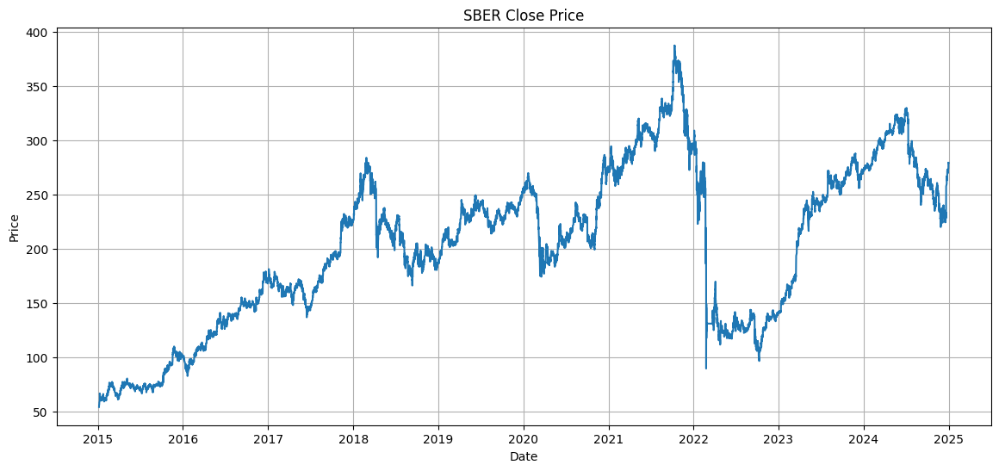

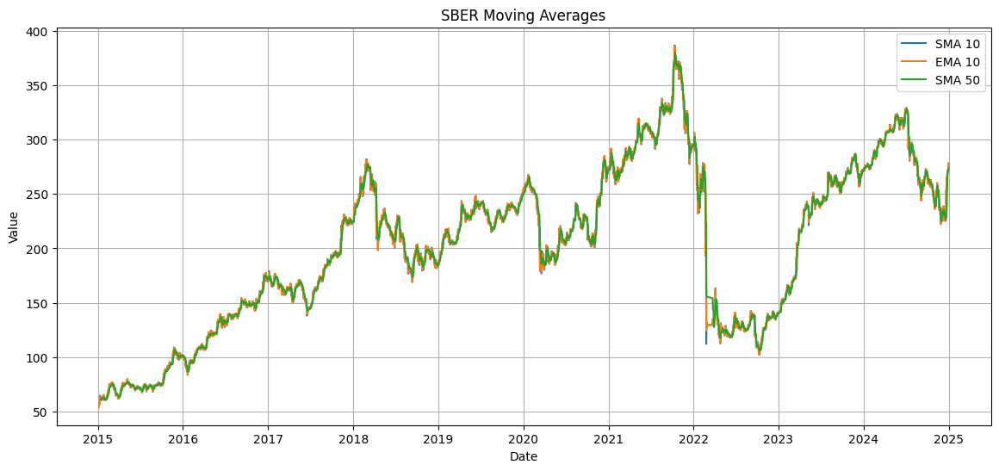

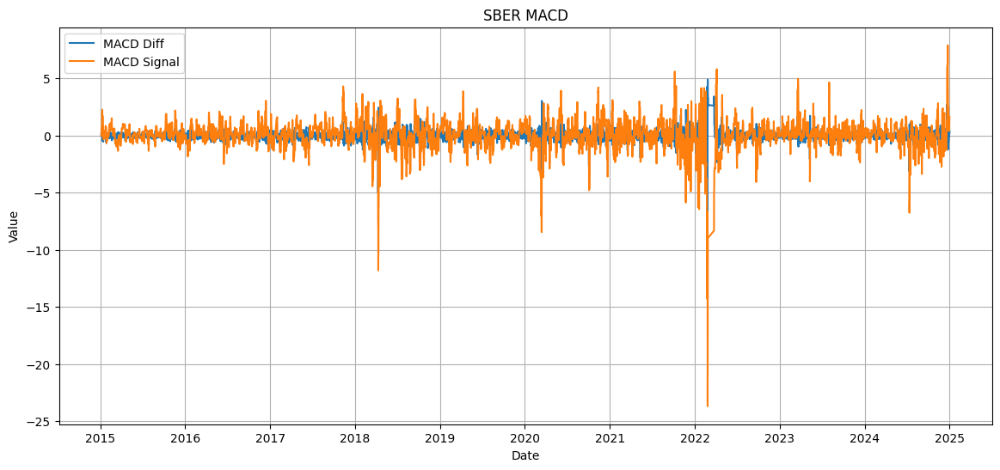

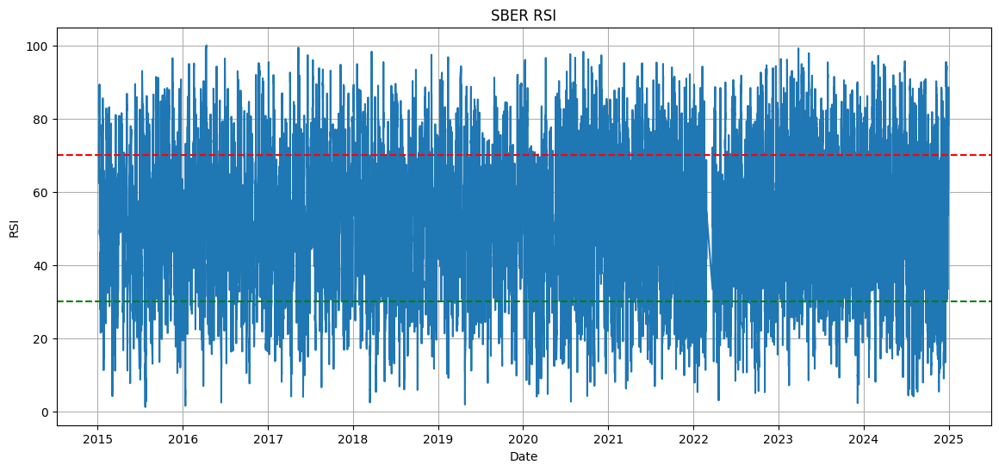

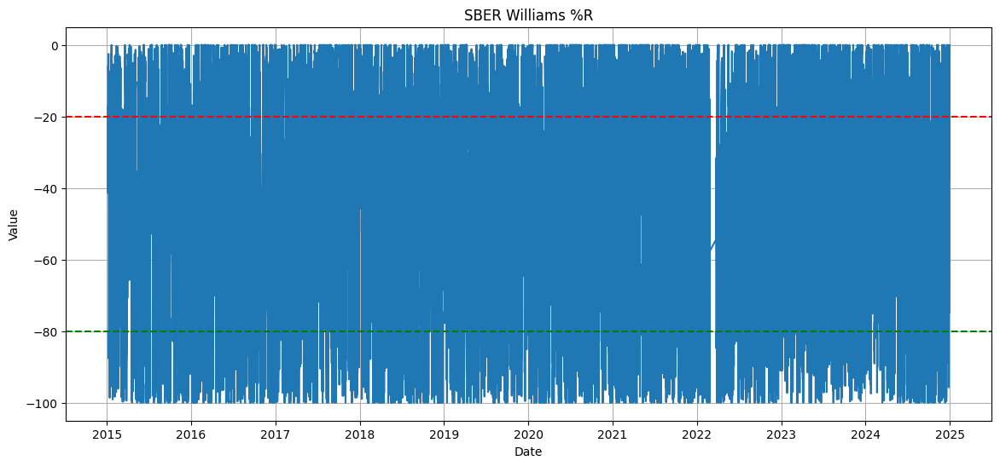

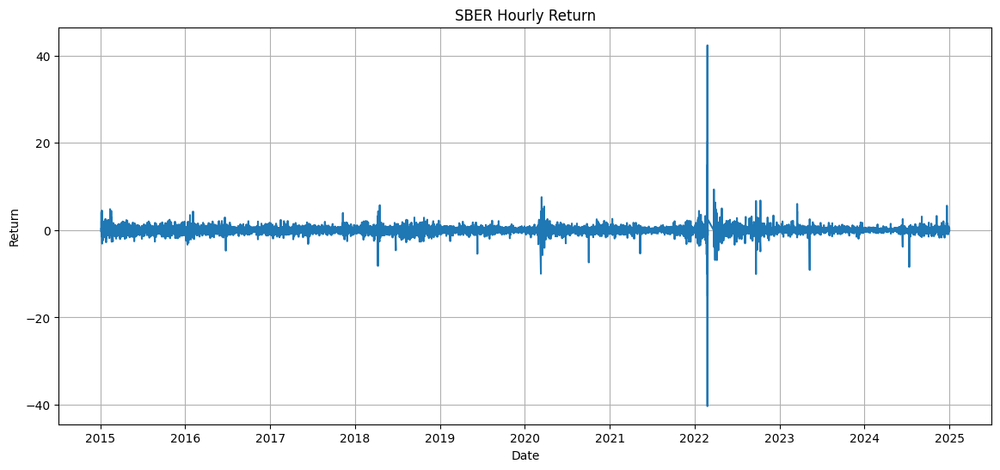

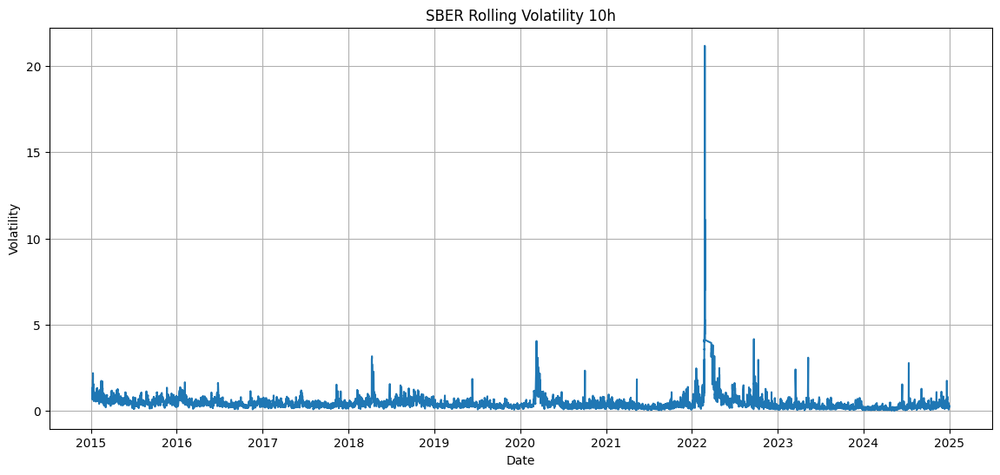

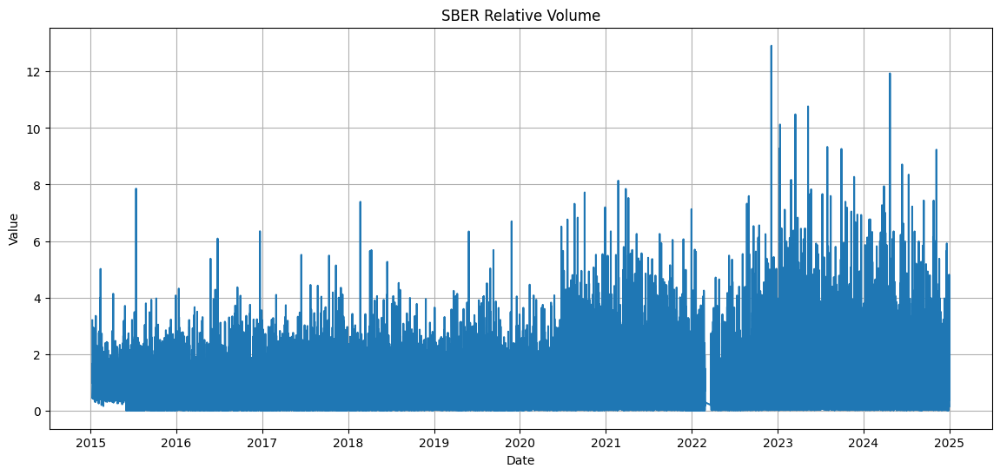

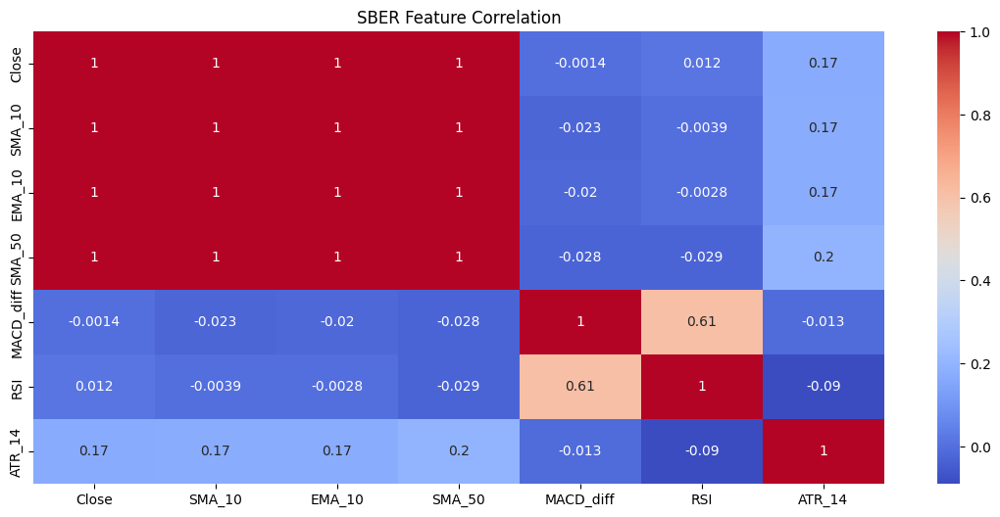

In [19]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

ticker = 'SBER'
df = globals()[f'df_{ticker}_hourly']

df['Date'] = pd.to_datetime(df['Date'])
last_year_start = df['Date'].max() - pd.Timedelta(days=365)
df = df[df['Date'] >= last_year_start]

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['Close'], name='Close Price'))
fig.update_layout(title=f'{ticker} Close Price', xaxis_title='Date', yaxis_title='Price')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['SMA_10'], name='SMA 10'))
fig.add_trace(go.Scatter(x=df['Date'], y=df['EMA_10'], name='EMA 10'))
fig.add_trace(go.Scatter(x=df['Date'], y=df['SMA_50'], name='SMA 50'))
fig.update_layout(title=f'{ticker} Moving Averages', xaxis_title='Date', yaxis_title='Value')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['MACD_diff'], name='MACD Diff'))
fig.add_trace(go.Scatter(x=df['Date'], y=df['MACD_signal'], name='MACD Signal'))
fig.update_layout(title=f'{ticker} MACD', xaxis_title='Date', yaxis_title='Value')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['RSI'], name='RSI'))
fig.add_hline(y=70, line_dash="dash", line_color="red")
fig.add_hline(y=30, line_dash="dash", line_color="green")
fig.update_layout(title=f'{ticker} RSI', xaxis_title='Date', yaxis_title='RSI')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['Williams_%R_hourly'], name='Williams %R'))
fig.add_hline(y=-20, line_dash="dash", line_color="red")
fig.add_hline(y=-80, line_dash="dash", line_color="green")
fig.update_layout(title=f'{ticker} Williams %R', xaxis_title='Date', yaxis_title='Value')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['HourlyReturn'], name='Hourly Return'))
fig.update_layout(title=f'{ticker} Hourly Return', xaxis_title='Date', yaxis_title='Return')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['RollingVol_10_hourly'], name='Rolling Volatility 10h'))
fig.update_layout(title=f'{ticker} Rolling Volatility', xaxis_title='Date', yaxis_title='Volatility')
fig.show()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df['Date'], y=df['RelativeVolume_hourly'], name='Relative Volume'))
fig.update_layout(title=f'{ticker} Relative Volume', xaxis_title='Date', yaxis_title='Value')
fig.show()

fig = px.imshow(df[['Close', 'SMA_10', 'EMA_10', 'SMA_50', 'MACD_diff', 'RSI', 'ATR_14']].corr(), text_auto=True, color_continuous_scale='RdBu')
fig.update_layout(title=f'{ticker} Feature Correlation Heatmap')
fig.show()


In [17]:
!pip install plotly

You should consider upgrading via the '/Users/nikitochka/venv/bin/python3 -m pip install --upgrade pip' command.
